In [ ]:
!pip install -U git+https://github.com/lyft/nuscenes-devkit moviepy >> /dev/tmp

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [23]:
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=FutureWarning)
from IPython.display import HTML

In [24]:
import pdb
import cv2
import pandas as pd
import numpy as np
from PIL import Image
from pathlib import Path
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import axes3d, Axes3D

# Load the SDK
from lyft_dataset_sdk.lyftdataset import LyftDataset, LyftDatasetExplorer, Quaternion, view_points
from lyft_dataset_sdk.utils.data_classes import LidarPointCloud

from moviepy.editor import ImageSequenceClip
from tqdm import tqdm_notebook as tqdm

%matplotlib inline

In [25]:
!ln -s /content/drive/Shareddrives/CMPE249\ Project/Lyft/train_images images
!ln -s /content/drive/Shareddrives/CMPE249\ Project/Lyft/train_maps maps
!ln -s /content/drive/Shareddrives/CMPE249\ Project/Lyft/train_lidar lidar

ln: failed to create symbolic link 'images/train_images': File exists
ln: failed to create symbolic link 'maps/train_maps': File exists
ln: failed to create symbolic link 'lidar/train_lidar': File exists


In [6]:
ARTIFACTS_FOLDER = "/content/drive/Shareddrives/CMPE249 Project/Lyft/artifacts"

In [26]:
lyftdata= LyftDataset(data_path='.', json_path='/content/drive/Shareddrives/CMPE249 Project/Lyft/train_data', verbose=True)

9 category,
18 attribute,
4 visibility,
18421 instance,
10 sensor,
148 calibrated_sensor,
177789 ego_pose,
180 log,
180 scene,
22680 sample,
189504 sample_data,
638179 sample_annotation,
1 map,
Done loading in 21.1 seconds.
Reverse indexing ...
Done reverse indexing in 7.3 seconds.


In [8]:
# Lyft has many tables such as cateogry,sample,callibration etc. first record of cateogry table
lyftdata.category[0]

{'description': '',
 'name': 'car',
 'token': '8eccddb83fa7f8f992b2500f2ad658f65c9095588f3bc0ae338d97aff2dbcb9c'}

In [17]:
# lets take a look at sample_annotation table
lyftdata.sample_annotation[0]

{'attribute_tokens': ['1ba8c9a8bda54423fa710b0af1441d849ecca8ed7b7f9393ba1794afe4aa6aa2',
  'daf16a3f6499553cc5e1df4a456de5ee46e2e6b06544686d918dfb1ddb088f6f'],
 'category_name': 'car',
 'instance_token': 'abea2eb040d9c8fa1a44fa54020daaf9e2aa696e95e1d257481ecbf6e13a318c',
 'next': '33e07b849d62718279c9548fe662d32247e319f0451cd461059305c3e42dcea0',
 'num_lidar_pts': -1,
 'num_radar_pts': 0,
 'prev': 'db2c5aea69d8be40a746c5f3df9366e030189b07647212f338b31240c15896df',
 'rotation': [0.265491936795379, 0, 0, 0.964113080243515],
 'sample_token': 'db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341',
 'size': [2.064, 5.488, 2.053],
 'token': '92bff46db1dbfc9679edc8091770c4256ac3c027e9f0a9c31dfc4fff41f6f677',
 'translation': [2680.2830359778527, 698.1969292852777, -18.04776692365821],
 'visibility_token': ''}

In [22]:
# using lyftsdk.get() method to check any of the attribute above. it tells about the state of object when it was annotated
lyftdata.get('attribute',lyftdata.sample_annotation[0]['attribute_tokens'][0])

{'description': '',
 'name': 'object_action_stopped',
 'token': '1ba8c9a8bda54423fa710b0af1441d849ecca8ed7b7f9393ba1794afe4aa6aa2'}

In [12]:
train = pd.read_csv('/content/drive/Shareddrives/CMPE249 Project/Lyft/train.csv')
train.head()
# id is the token in sample table whereas predicition string corresponds to ground truth annotationx

,Id,PredictionString
0,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,2680.2830359778527 698.1969292852777 -18.04776...
1,edf37c1fb1024ba0c1f53ebbf10b6797f781199a9f0e4e...,1208.642684768659 1585.1812946970927 -23.56236...
2,1841b7895e7163a2c1be87e8c1740e759a910cd59157b8...,848.9346793681768 2587.2870557176507 -20.15995...
3,a970c764e7abd7ebc2cc4599a6e3ae58c9773ea3c9cf1d...,1994.4320280494098 1128.30164336183 -18.054752...
4,b909de93ba19460eeea58074ccc1ef6bb302435f37b48c...,1030.3877156973385 1667.13131694941 -23.764820...


In [29]:
token = train.iloc[1]['Id']
token
#lets take this token to visualize it

'edf37c1fb1024ba0c1f53ebbf10b6797f781199a9f0e4e25274df2448966d929'

In [27]:
#Scene is  25-45s long sequence of consecutive frames and a frame is collection of sensor's output at different timestamps.
lyftdata.scene[0]

{'description': '',
 'first_sample_token': '24b0962e44420e6322de3f25d9e4e5cc3c7a348ec00bfa69db21517e4ca92cc8',
 'last_sample_token': '2346756c83f6ae8c4d1adec62b4d0d31b62116d2e1819e96e9512667d15e7cec',
 'log_token': 'da4ed9e02f64c544f4f1f10c6738216dcb0e6b0d50952e158e5589854af9f100',
 'name': 'host-a101-lidar0-1241893239199111666-1241893264098084346',
 'nbr_samples': 126,
 'token': 'da4ed9e02f64c544f4f1f10c6738216dcb0e6b0d50952e158e5589854af9f100'}

In [30]:
my_sample = lyftdata.get('sample', token)
my_sample

{'anns': ['04c4c9883de582c5c4e7a45273a978a52b0432de18883f60e7dd0e5cd2137628',
  'fa0f894b7dbfcb69820ca364910e7631a48c17647a7910062267a8586a65c924',
  '7e17466f4f791ea12d901d488cadb55c3036ed5a04364b4013e967e6e3ceb2fc',
  '034103a77d790b8f89e68c1f076d77812913fcfe2c2b41de746882d437525e22',
  'd9b211f342861956e10f95017176c0d7f5140fddb0a478d53fb955383b9ff794',
  '670f541c32c8c025eac31f03170bb1e4bb7478063ec7ca55bc453784866a9708',
  '6b94039dd917fa5cf2896697041a841b9e238d9c05c7a38afc1bbb3ed9552acd',
  '9c8df124b641892094971c19346e53e32d9b4f0cb9a39085aa83a2be7cb68ba2',
  '5c68880f8ac1f4dc19f61a38e7bdf1e9e921e777387ac465a1607aa069f78053',
  'c680e9d2c9ae4b2ff63103a831a6020426ae25dc74eb2ada7290861c5b3ea6ea',
  '8d456eeb04b2de3f344c495190110644a78d13c06efc357e39a495c441a89c37',
  'b4957537dc87f55350dce0f460d75e9b3bc0ec6f8c034d15928bde7f0461a207',
  '2184a9c9bc23f9bdf83f447b9877cf85a962f891b5d6520002885bd3d03cbfad',
  'd69e011788103e8d67d4e4c99063d6687cb975174e014e9db7912ead7f96e00d',
  '68ab34ef5

In [16]:
#3d visualization of sample token using luft sdk 3d operation
lyftdata.render_sample_3d_interactive(my_sample['token'], render_sample=False)

In [ ]:
lyftdata.sensor

[{'channel': 'CAM_FRONT_LEFT',
  'modality': 'camera',
  'token': 'f7dad6bb70cb8e6245f96e5537e382848335872e6e259218b0a80cc071d162c4'},
 {'channel': 'LIDAR_FRONT_LEFT',
  'modality': 'lidar',
  'token': '629da739ea3a0814b9d79ffc3b99cdbc8bdbb6f97abf139f1ad33bd12f8fa94d'},
 {'channel': 'CAM_FRONT',
  'modality': 'camera',
  'token': 'eb9e8f60a3d6e3328d7512b9f8e6800127fe91f4d62bc8e48a0e6a7cb116cc60'},
 {'channel': 'LIDAR_TOP',
  'modality': 'lidar',
  'token': '25bf751d7e35f295393d8a418731474b21c1f702e878c4553f112397caa48c08'},
 {'channel': 'CAM_BACK_LEFT',
  'modality': 'camera',
  'token': 'c84592e22beb2c0f14d5159245ce8d6678431b879e940eed580651c09cc7d2f1'},
 {'channel': 'LIDAR_FRONT_RIGHT',
  'modality': 'lidar',
  'token': '953faed96fd3d2fae3ec03cd2838b312b8c1a9bb7a0629481982870cb28acb67'},
 {'channel': 'CAM_BACK',
  'modality': 'camera',
  'token': '172a55e2b50f18a6b6d545369a457003c2f3b438d0180b2b4c7819ca29b3f6ab'},
 {'channel': 'CAM_BACK_RIGHT',
  'modality': 'camera',
  'token': '8e0

In [31]:
lidar_top = lyftdata.get('sample_data', my_sample['data']['LIDAR_TOP']) # selecting LIDAR_TOP out of all LIDARs
lidar_top

{'calibrated_sensor_token': 'c6a9403b59c075f6940fa1758fa336f972a09d8693cf09937159c03e0be88078',
 'channel': 'LIDAR_TOP',
 'ego_pose_token': 'f5d59fb8d4b7903ec8a9436ce1f1063d1836c9386b22def05227de7e9fd07c8a',
 'fileformat': 'bin',
 'filename': 'lidar/host-a011_lidar1_1232905806002498246.bin',
 'is_key_frame': True,
 'next': '635c76858db6593bffef8d4c350167295ad61431c30167e076fdadfaf9f1886b',
 'prev': '24240175a894458a0eddd26668e06cd1fc87ffabf83aefe297de36babefad8eb',
 'sample_token': 'edf37c1fb1024ba0c1f53ebbf10b6797f781199a9f0e4e25274df2448966d929',
 'sensor_modality': 'lidar',
 'timestamp': 1548870606002498.2,
 'token': '0a11b9332f9dc7c4c7cf231d9a3dd0d6d0637f5167d067eb0e4ef5111d880228'}

In [32]:
pc = LidarPointCloud.from_file(Path(lidar_top['filename']))

In [33]:
axes_limits = [
    [-30, 50], # X axis range
    [-30, 20], # Y axis range
    [-3, 10]   # Z axis range
]
axes_str = ['X', 'Y', 'Z']

def display_frame_statistics(lidar_points, points=0.2):
    """
    Displays statistics for a single frame. Draws 3D plot of the lidar point cloud data and point cloud
    projections to various planes.
    
    Parameters
    ----------
    lidar_points: lidar data points 
    points          : Fraction of lidar points to use. Defaults to `0.2`, e.g. 20%.
    """
    
    points_step = int(1. / points)
    point_size = 0.01 * (1. / points)
    pc_range = range(0, lidar_points.shape[1], points_step)
    pc_frame = lidar_points[:, pc_range]
    def draw_point_cloud(ax, title, axes=[0, 1, 2]):
        """Convenient method for drawing various point cloud projections as a part of frame statistics"""
        ax.set_facecolor('black')
        ax.grid(False)
        ax.scatter(*pc_frame[axes, :], s=point_size, c='white', cmap='grey')
        if len(axes) == 3: # 3D configs
            text_color = 'white'
            ax.set_xlim3d([-10, 30])
            ax.set_ylim3d(*axes_limits[axes[1]])
            ax.set_zlim3d(*axes_limits[axes[2]])
            ax.set_zlabel('{} axis'.format(axes_str[axes[2]]), color='white')
        else: # 2D configs
            text_color = 'black' # the `figure` is white
            ax.set_xlim(*axes_limits[axes[0]])
            ax.set_ylim(*axes_limits[axes[1]])
        ax.set_title(title, color=text_color)
        ax.set_xlabel('{} axis'.format(axes_str[axes[0]]), color=text_color)
        ax.set_ylabel('{} axis'.format(axes_str[axes[1]]), color=text_color)
            
    # Draw point cloud data as 3D plot
    f2 = plt.figure(figsize=(15, 8))
    ax2 = f2.add_subplot(111, projection='3d')
    # make the panes transparent
    ax2.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax2.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax2.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    draw_point_cloud(ax2, '3D plot')
    
    plt.show()
    plt.close(f2)
    # Draw point cloud data as plane projections
    f, ax3 = plt.subplots(3, 1, figsize=(15, 25))
#     f.set_facecolor('black')
    draw_point_cloud(
        ax3[0], 
        'XZ projection (Y = 0)', #, the car is moving in direction left to right', ?
        axes=[0, 2] # X and Z axes
    )
    draw_point_cloud(
        ax3[1], 
        'XY projection (Z = 0)', #, the car is moving in direction left to right',? 
        axes=[0, 1] # X and Y axes
    )
    draw_point_cloud(
        ax3[2], 
        'YZ projection (X = 0)', #, the car is moving towards the graph plane', ?
        axes=[1, 2] # Y and Z axes
    )
    plt.show()
    plt.close(f)

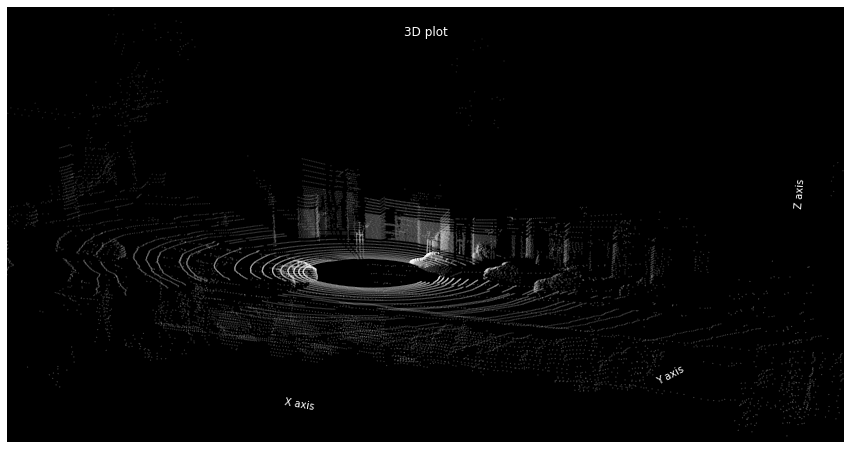

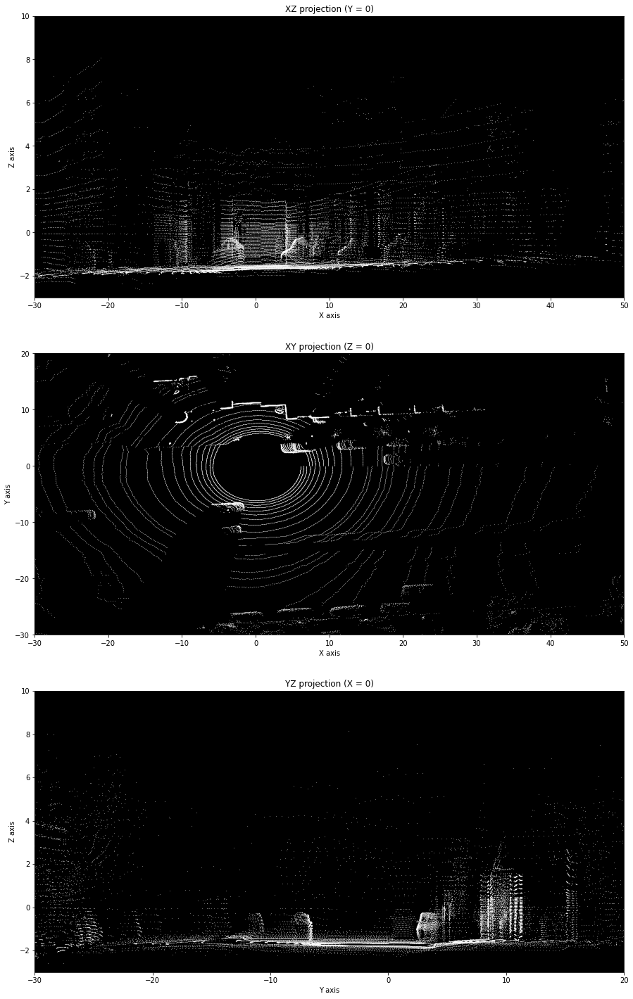

In [34]:
#Visualizing Lidar Points and projectins on different planes
#XZ plane: the car is moving in direction left to right
#
display_frame_statistics(pc.points, points=0.5)

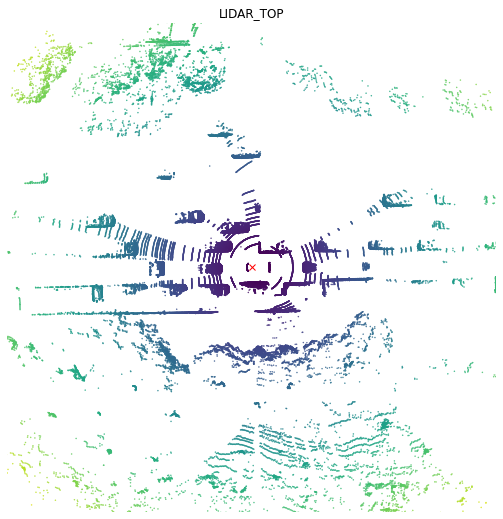

In [ ]:
lyftdata.render_sample_data(lidar_top['token'], with_anns=False)

In [ ]:
# ego pose contains the location(translation )and orientation(rotation) of ego vehicle's body frame wrt global frame
lyftdata.get('ego_pose', cam_front['ego_pose_token'])
#ego parameters are used to bring points from global coordinates to ego vehicle frame of reference.

{'rotation': [0.2781972991626702,
  -3.898219099753439e-05,
  0.010984161409140781,
  0.9604611441474988],
 'timestamp': 1558109692502687.0,
 'token': 'dfba284cabe099bbe89ff13355a7702828d02709f82579f1e49081479cb09dfe',
 'translation': [2706.450326057958, 694.5009240389028, -19.260889292536774]}

In [ ]:
# definition of particular sensor callibrated on particular vehicel. Each sensor has got calibrated paramters wrt ego vehicle.
lyftdata.get('calibrated_sensor', cam_front['calibrated_sensor_token'])
#extrinsic parameters are given wrt to ego vehcile's body frame. we use calibrated parameters to bring points from ego vehicle frame
# of reference to sensor's frame of refernce. It is used to plot bounding box in images and lidar point cloud.

{'camera_intrinsic': [[1109.05239567, 0, 957.849065461],
  [0.0, 1109.05239567, 539.672710373],
  [0.0, 0.0, 1.0]],
 'rotation': [0.5090416344726354,
  -0.49422295323980653,
  0.4930125688749941,
  -0.5035463174283287],
 'sensor_token': 'eb9e8f60a3d6e3328d7512b9f8e6800127fe91f4d62bc8e48a0e6a7cb116cc60',
 'token': '8e73e320d1fa9e5af96059e6eb1dd7d28e3271dea04de86ead47fa25fd13fd20',
 'translation': [1.5039405282244198, -0.02676183592864872, 1.6584901808053665]}

In [35]:
#annotations refers to bounding box defining position of an object seen ina sample.
my_annotation = lyftdata.get('sample_annotation', my_sample['anns'][0])
my_annotation

{'attribute_tokens': ['7fc1ca3d36808cd1858e9c01ad4e7630ff3ca9e720065034abd244122646acc8'],
 'category_name': 'car',
 'instance_token': 'c3824f5ed11d382a4742d00a3a2e8deea4e6c21198151c94d371f6576d2735ed',
 'next': '1b29baa915a0e1835b322e83efe0cfaa9b483fa96e1b34cef73ec95d5b035e5d',
 'num_lidar_pts': -1,
 'num_radar_pts': 0,
 'prev': 'fadeb42661a9af6ff36d3ee60bb68b01a03c59e83bdcdcb227d70c426785bfd0',
 'rotation': [-0.9603683930256266, 0, 0, 0.2787338330331926],
 'sample_token': 'edf37c1fb1024ba0c1f53ebbf10b6797f781199a9f0e4e25274df2448966d929',
 'size': [1.635, 4.339, 1.515],
 'token': '04c4c9883de582c5c4e7a45273a978a52b0432de18883f60e7dd0e5cd2137628',
 'translation': [1208.642684768659, 1585.1812946970927, -23.56236391728106],
 'visibility_token': ''}

In [36]:
my_box = lyftdata.get_box(my_annotation['token'])
my_box # Box class instance

label: nan, score: nan, xyz: [1208.64, 1585.18, -23.56], wlh: [1.64, 4.34, 1.51], rot axis: [0.00, 0.00, 1.00], ang(degrees): -32.37, ang(rad): -0.56, vel: nan, nan, nan, name: car, token: 04c4c9883de582c5c4e7a45273a978a52b0432de18883f60e7dd0e5cd2137628

In [37]:
# instances are object that need to be detected
my_instance = lyftdata.get('instance', my_annotation['instance_token'])
my_instance

{'category_token': '8eccddb83fa7f8f992b2500f2ad658f65c9095588f3bc0ae338d97aff2dbcb9c',
 'first_annotation_token': '454806be7c74f0e68ef293a009a7bcd3af215e29b1a773a852b1e14320b0eb24',
 'last_annotation_token': '14bfa5f475cf874e0408be18199a8e7414cf039ca0810f9f564ca34493015cf3',
 'nbr_annotations': 29,
 'token': 'c3824f5ed11d382a4742d00a3a2e8deea4e6c21198151c94d371f6576d2735ed'}

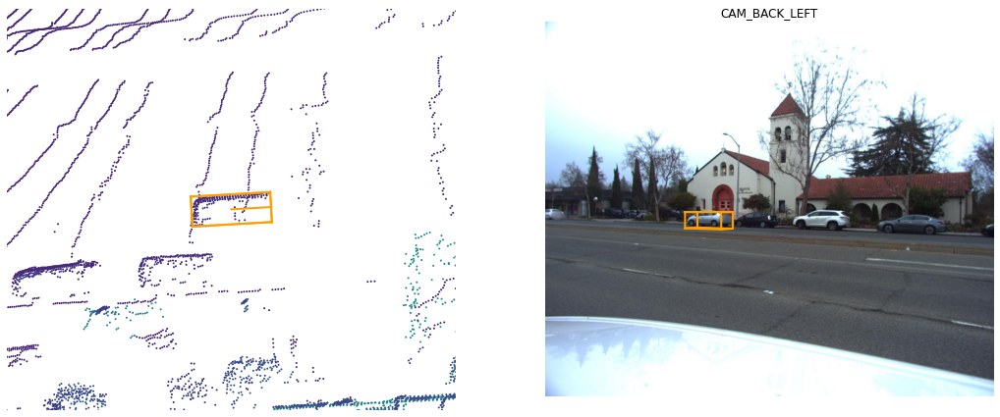

In [40]:
lyftdata.render_annotation(my_annotation['token'], margin=10)

#### 3D visualization of a scene

In [43]:
#3d Visualization of a scene
my_scene = lyftdata.get('scene',  my_sample['scene_token'])
def get_lidar_points(lidar_token):
    '''Get lidar point cloud in the frame of the ego vehicle'''
    sd_record = lyftdata.get("sample_data", lidar_token)
    sensor_modality = sd_record["sensor_modality"]
    
    # Get aggregated point cloud in lidar frame.
    sample_rec = lyftdata.get("sample", sd_record["sample_token"])
    chan = sd_record["channel"]
    ref_chan = "LIDAR_TOP"
    pc, times = LidarPointCloud.from_file_multisweep(
        lyftdata, sample_rec, chan, ref_chan, num_sweeps=1
    )
    # Compute transformation matrices for lidar point cloud
    cs_record = lyftdata.get("calibrated_sensor", sd_record["calibrated_sensor_token"])
    pose_record = lyftdata.get("ego_pose", sd_record["ego_pose_token"])
    vehicle_from_sensor = np.eye(4)
    vehicle_from_sensor[:3, :3] = Quaternion(cs_record["rotation"]).rotation_matrix
    vehicle_from_sensor[:3, 3] = cs_record["translation"]
    
    ego_yaw = Quaternion(pose_record["rotation"]).yaw_pitch_roll[0]
    rot_vehicle_flat_from_vehicle = np.dot(
        Quaternion(scalar=np.cos(ego_yaw / 2), vector=[0, 0, np.sin(ego_yaw / 2)]).rotation_matrix,
        Quaternion(pose_record["rotation"]).inverse.rotation_matrix,
    )
    vehicle_flat_from_vehicle = np.eye(4)
    vehicle_flat_from_vehicle[:3, :3] = rot_vehicle_flat_from_vehicle
    points = view_points(
        pc.points[:3, :], np.dot(vehicle_flat_from_vehicle, vehicle_from_sensor), normalize=False
    )
    return points
def draw_3d_plot(idx, lidar_token):
    '''Plot the lidar + annotations on a 3D figure'''
    # sample lidar point cloud
    lidar_points = get_lidar_points(lidar_token)
    points = 0.5 # fraction of lidar_points to plot, to reduce the clutter
    points_step = int(1. / points)
    pc_range = range(0, lidar_points.shape[1], points_step)
    lidar_points = lidar_points[:, pc_range]
    
    # Get boxes, instead of current sensor's coordinate frame, use vehicle frame which is aligned to z-plane in world
    _, boxes, _ = lyftdata.get_sample_data(
        lidar_token, flat_vehicle_coordinates=True
    )
    fig = plt.figure(figsize=(15, 8))
    ax = fig.add_subplot(111, projection='3d')                    
    point_size = 0.01 * (1. / points) # size of the dots on plot
    ax.set_facecolor('black')
    ax.grid(False)
    ax.scatter(*lidar_points, s=point_size, c='white', cmap='gray')
    for box in boxes:
        c = np.array(lyftdata.explorer.get_color(box.name)) / 255.0
        plot_box(box, ax, view=np.eye(3), colors=(c, c, c), linewidth=0.5)
    ax.set_xlim3d(-40, 40)
    ax.set_ylim3d(-40, 40)
    ax.set_zlim3d(-4, 40)
    
    # make the panes transparent
    ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.set_title(lidar_token, color='white')
    filename = 'tmp/frame_{0:0>4}.png'.format(idx)
    plt.savefig(filename)
    plt.close(fig)
    return filename
def plot_box(box, axis, view, colors, normalize=False, linewidth=1.0):
    '''Plot boxes in the 3d figure'''
    corners = view_points(box.corners(), view, normalize=normalize)#
    def draw_rect(selected_corners, color):
        prev = selected_corners[-1]
        for corner in selected_corners:
            axis.plot([prev[0], corner[0]], [prev[1], corner[1]], [prev[2], corner[2]], color=color, linewidth=linewidth)
            prev = corner

    # Draw the sides
    for i in range(4):
        axis.plot(
            [corners.T[i][0], corners.T[i + 4][0]],
            [corners.T[i][1], corners.T[i + 4][1]],
            [corners.T[i][2], corners.T[i + 4][2]],
            color=colors[2],
            linewidth=linewidth,
        )

    # Draw front (first 4 corners) and rear (last 4 corners) rectangles(3d)/lines(2d)
    draw_rect(corners.T[:4], colors[0]) #4x3
    draw_rect(corners.T[4:], colors[1])

In [46]:
!mkdir tmp # a temporary folder to contain plot jpegs
# let's take a quick look at the 3d Plot
first_sample_token = my_scene['first_sample_token']
sample = lyftdata.get('sample', first_sample_token)
lidar_token = sample['data']['LIDAR_TOP']
filename = draw_3d_plot(0, lidar_token)
Image.open(filename)
frames = []
first_sample_token = my_scene['first_sample_token']
token = first_sample_token
for i in tqdm(range(my_scene['nbr_samples'])):
    sample = lyftdata.get('sample', token)
    lidar_token = sample['data']['LIDAR_TOP']
    filename = draw_3d_plot(i, lidar_token)
    frames += [filename]
    token = sample['next']

mkdir: cannot create directory ‘tmp’: File exists


In [48]:
clip = ImageSequenceClip(frames, fps=5)
clip.write_gif('pcl_data.gif', fps=5);
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
from IPython import display


t:   2%|▏         | 3/126 [00:00<00:06, 20.44it/s, now=None]

MoviePy - Building file pcl_data.gif with imageio.


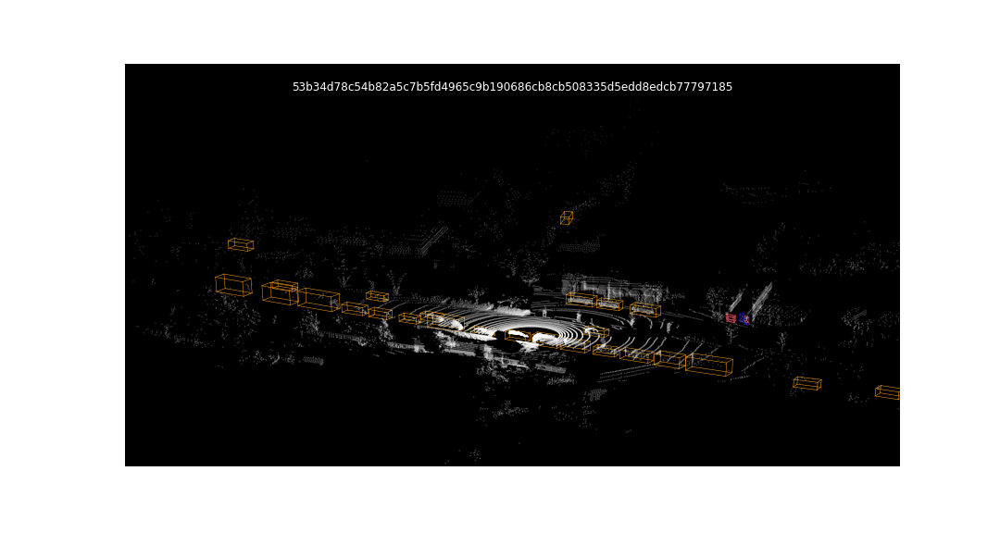

In [49]:
with open('pcl_data.gif','rb') as f:
    display.Image(data=f.read(), format='png')